In [1]:
# !wget https://www.openslr.org/resources/12/dev-clean.tar.gz -O /root/thesis-work/data/dev-clean.tar.gz

In [2]:
# import tarfile
# file = tarfile.open("./data/dev-clean.tar.gz")
# file.extractall('./data/speech')
# file.close()

In [3]:
# !pip install pydub
# !pip install matplotlib

In [1]:
file_path = './data/speech/LibriSpeech/dev-clean/7850/286674/7850-286674-0017.flac'

In [2]:
import soundfile as sf

data, samplerate = sf.read(file_path)

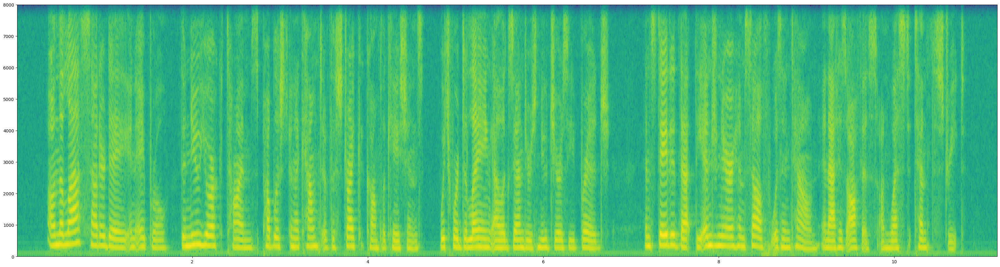

<Figure size 1850x1050 with 0 Axes>

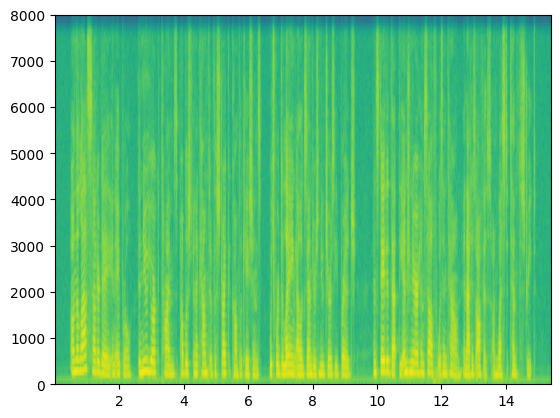

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [28]:
import matplotlib.pyplot as plt 

powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(data, Fs=samplerate) 
plt.show()

In [4]:
from IPython.display import Audio, display

In [8]:
Audio(file_path)

In [9]:
# !pip install scipy

In [27]:
from python_speech_features import mfcc

mfcc_data = mfcc(data, samplerate)

import numpy as np
from matplotlib import cm

figg = plt.gcf()
figg.set_size_inches(18.5, 10.5)
# figg.savefig('test2png.png', dpi=100)

fig, ax = plt.subplots()
fig.set_size_inches(15, 10.5)
mfcc_data= np.swapaxes(mfcc_data, 0 ,1)
cax = ax.imshow(mfcc_data, interpolation='nearest', cmap=cm.coolwarm, origin='lower')
ax.set_title('MFCC')

plt.show()

AttributeError: module 'matplotlib' has no attribute 'axes'

In [26]:
import numpy as np
np.random.seed(42)

def noise_psd(N, psd = lambda f: 1):
        X_white = np.fft.rfft(np.random.randn(N));
        S = psd(np.fft.rfftfreq(N))
        # Normalize S
        S = S / np.sqrt(np.mean(S**2))
        X_shaped = X_white * S;
        return np.fft.irfft(X_shaped);

def PSDGenerator(f):
    return lambda N: noise_psd(N, f)

@PSDGenerator
def white_noise(f):
    return 1;

@PSDGenerator
def blue_noise(f):
    return np.sqrt(f);

@PSDGenerator
def violet_noise(f):
    return f;

@PSDGenerator
def brownian_noise(f):
    return 1/np.where(f == 0, float('inf'), f)

@PSDGenerator
def pink_noise(f):
    return 1/np.where(f == 0, float('inf'), np.sqrt(f))

@PSDGenerator
def general_noise(f, alpha = 1):
    return np.where(f==0 and alpha < 0, float('inf'), np.pow(f, alpha))

def plot_spectrum(s):
    f = np.fft.rfftfreq(len(s))
    return plt.loglog(f, np.abs(np.fft.rfft(s)))[0]

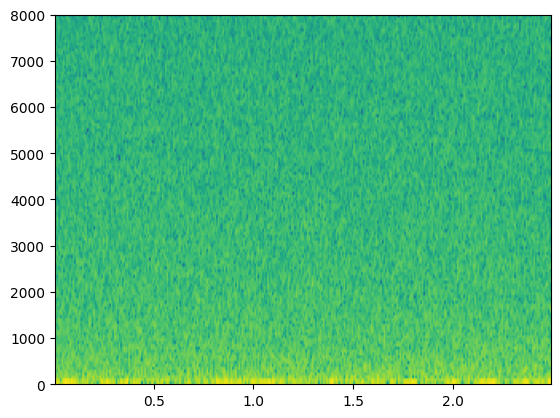

In [10]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(pink_noise(40000), Fs=samplerate) 
plt.show()

In [11]:
import colorednoise as cn
noise_audio = cn.powerlaw_psd_gaussian(1, 3277440)
noise_audio = noise_audio / max(abs(noise_audio))
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(highwat, Fs=16000)
plt.show()

NameError: name 'highwat' is not defined

In [32]:
Audio(data=highwat,rate=samplerate)

In [17]:
highwat, r = sf.read("./highway-14475.flac")
print(highwat.shape)

(3277440, 2)


In [18]:
highwat[0].shape
nnn = (highwat.T[0] + highwat.T[1])/2
nnn.shape

(3277440,)

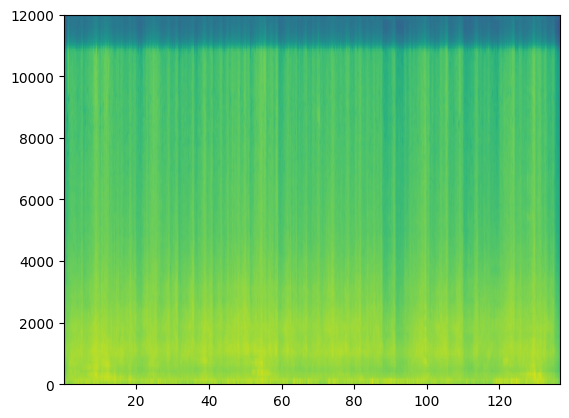

In [19]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(nnn, Fs=r)
plt.show()

In [17]:
Audio(data=nnn, rate=r)

In [20]:

ccc = nnn[:len(data)]
ccc.shape

(43920,)

In [32]:
import pyplnoise
import soundfile as sf

# ccc = nnn[:len(data)]

# ccc = highwat[:len(data)]

# Define the length of the pink noise to match the audio
noise_length = len(data)

def getNewAudio(d, fmax: float, desired_noise_level = 0.001):
    # Generate noise
    # noise = pyplnoise.PinkNoise(samplerate, 10e-2, fmax, seed=42).get_series(len(d))
    noise = pyplnoise.WhiteNoise(samplerate, seed=42).get_series(len(d))
    
    # Calculate the scaling factor based on the desired noise level
    scaling_factor = desired_noise_level / max(abs(noise))

    # Scale the pink noise
    noise_scaled = noise * scaling_factor

    # Add the pink noise to the audio
    return d + noise_scaled
    # return ccc + data
    
print(samplerate)

# audio_with_pink_noise = getNewAudio(2000.)
# audio_with_pink_noise2 = getNewAudio(400.)

# # Audio(audio_with_pink_noise)
# plt.subplot(211)
# powerSpectrum2, frequenciesFound2, time2, imageAxis2 = plt.specgram(audio_with_pink_noise, Fs=samplerate) 
# plt.subplot(212)
# powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(audio_with_pink_noise2, Fs=samplerate) 

q = (10, 100, 200, 400, 800, 1600, 2000, 4000, 8000)

c = 0
fig, axs = plt.subplots(len(q) + 1)
for i in q:
    audio_with_pink_noise = getNewAudio(data, i)
    powerSpectrum2, frequenciesFound2, time2, imageAxis2 = axs[c].specgram(audio_with_pink_noise, Fs=samplerate) 
    axs[c].set_title(q[c])
    c += 1

powerSpectrum, frequenciesFound, time, imageAxis = axs[-1].specgram(data, Fs=samplerate) 
    
plt.show()

16000


AttributeError: module 'matplotlib' has no attribute 'axes'

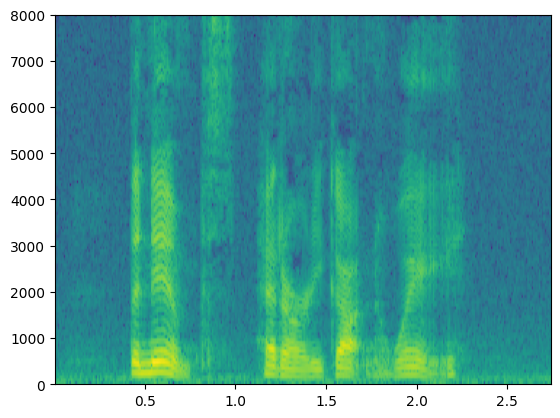

In [42]:
audio_noise = getNewAudio(8000, desired_noise_level=0.01)
audio_noise_2 = data + getNewAudio(8000, desired_noise_level=0.0001)
plt.specgram(audio_noise_2, Fs=samplerate) 
plt.show()

In [36]:
Audio(data=audio_with_pink_noise, rate=samplerate)
# Audio(data=audio_with_pink_noise, rate=samplerate)

<Figure size 1850x1050 with 0 Axes>

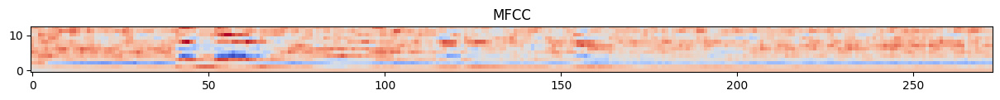

In [37]:
from python_speech_features import mfcc

mfcc_data = mfcc(audio_with_pink_noise, samplerate)

import numpy as np
from matplotlib import cm

figg = plt.gcf()
figg.set_size_inches(18.5, 10.5)
# figg.savefig('test2png.png', dpi=100)

fig, ax = plt.subplots()
# fig.set_size_inches(15, 10.5)
mfcc_data= np.swapaxes(mfcc_data, 0 ,1)
cax = ax.imshow(mfcc_data, interpolation='nearest', cmap=cm.coolwarm, origin='lower')
ax.set_title('MFCC')

plt.show()

In [12]:
import librosa

highwat, r = librosa.load("./highway-14475.flac", sr=16000)
print(highwat.shape)

(2184960,)


In [14]:
# !pip install librosa

In [15]:
# !pip install Cython
# !pip install pydsm

In [16]:
# !apt-cache search openblas
# !sudo apt-get install libfoo-dev

In [22]:
audio_test = getNewAudio(100)

In [23]:
pre_emphasis = 0.97
emphasized_audio = np.append(audio_test[0], audio_test[1:] - pre_emphasis * audio_test[:-1])


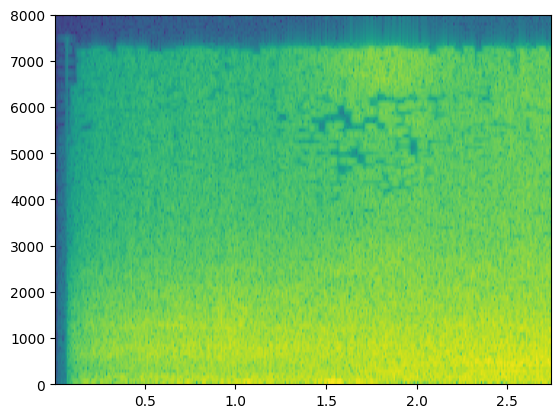

In [32]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(ccc, Fs=samplerate)
plt.show()

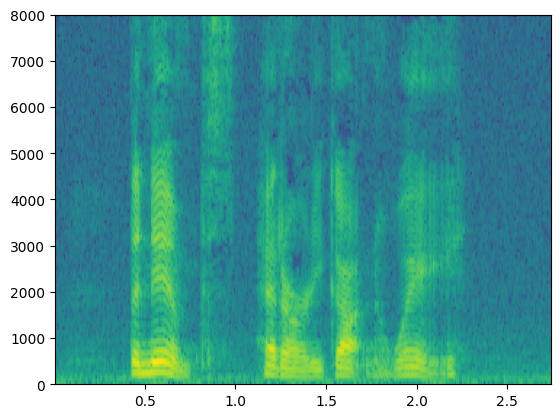

In [31]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(data, Fs=samplerate)
plt.show()

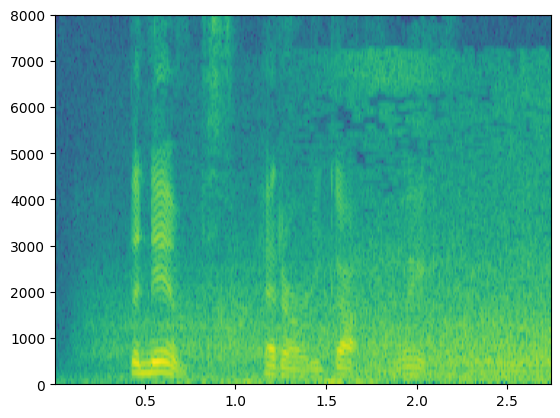

In [30]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(audio_test, Fs=samplerate)
plt.show()

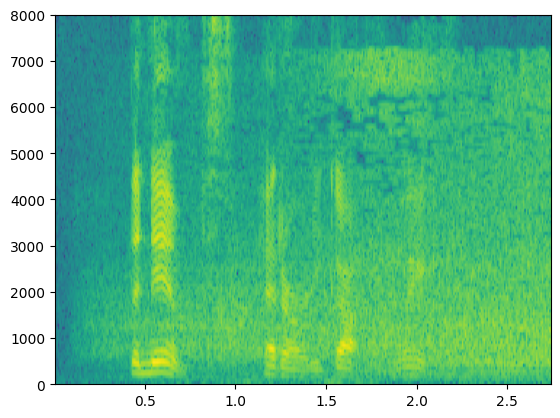

In [27]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(emphasized_audio, Fs=samplerate)
plt.show()

In [29]:
Audio(data=emphasized_audio, rate=samplerate)

In [2]:
import preprocessors

In [3]:
import transformers

In [3]:
# !pip install pandas

In [2]:
import importlib
import preprocessors
importlib.reload(preprocessors)

<module 'preprocessors' from '/root/thesis-work/preprocessors.py'>

In [7]:
import data_preparer
importlib.reload(data_preparer)

dataset = data_preparer.getDataset()

In [51]:
# !pip install tqdm

In [59]:
import preprocessors

In [18]:
importlib.reload(preprocessors)
from preprocessors import AudioReader
for i in range(100):
    # q = WavReader.get_spectrogram(dataset[i][0], 256, 160, 384)
    q = AudioReader.get_mfcc(dataset[i][0])
    # print(q.shape)

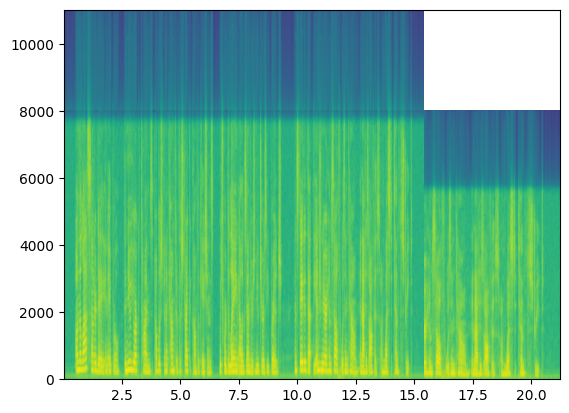

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [14]:
import matplotlib.pyplot as plt
import numpy as np
import librosa
data = np.array([])
spectrogram = dataset[0][0]
samplerate=16000
if isinstance(spectrogram, str):
    data, sr = librosa.load(spectrogram)
    if samplerate is None:
        samplerate = sr
    if samplerate != sr:
        data = librosa.resample(data, orig_sr=sr, target_sr=samplerate)
else:
    data = spectrogram
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(data, Fs=samplerate)
plt.show()
print(samplerate)

In [46]:
samplerate

16000

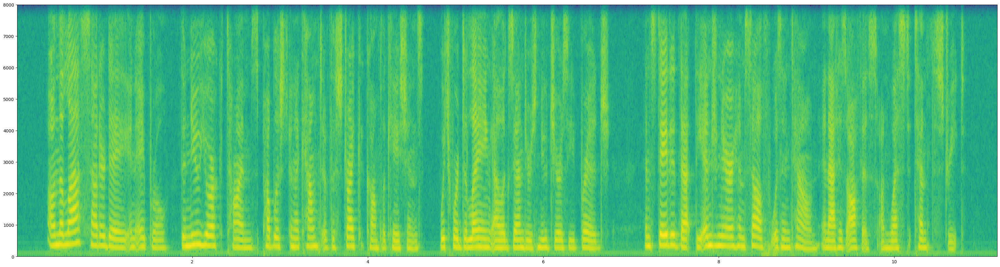

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [23]:
aa = librosa.resample(data, orig_sr=sr,target_sr=16000)
fig = plt.gcf()
fig.set_size_inches(40.5, 10.5)
AudioReader.plot_spectrogram(aa, samplerate=16000)

In [20]:
plt.clf()

In [ ]:
from IPython.display import Audio
Audio(data=aa, rate=16000)

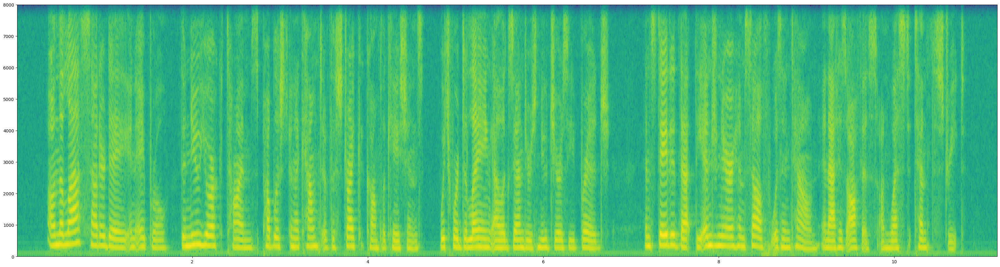

<Figure size 1850x1050 with 0 Axes>

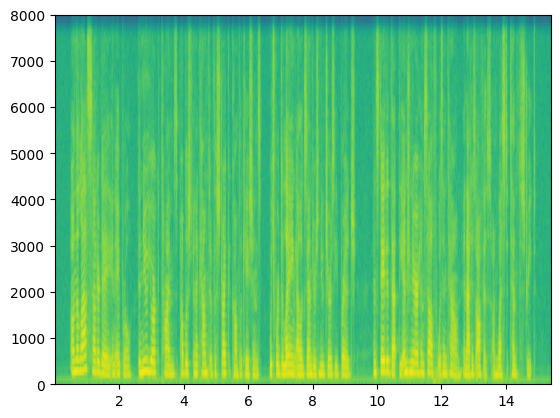

<Figure size 640x480 with 0 Axes>

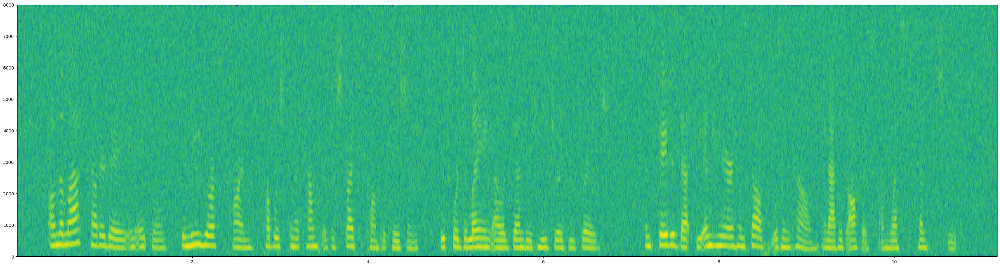

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [41]:
t = getNewAudio(aa, 16000, desired_noise_level=0.1)
fig = plt.gcf()
fig.set_size_inches(40.5, 10.5)
AudioReader.plot_spectrogram(t, samplerate=16000)
Audio(t, rate=16000)

In [48]:
Audio(t, rate=11000)

In [37]:
t[0]

0.12166510651627763

In [38]:
aa[0]

-4.560434e-05

In [49]:
import tensorflow as tf

2023-06-04 23:45:26.144346: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-06-04 23:45:26.522287: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-06-04 23:45:26.524994: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-04 23:45:29.045822: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [57]:
d = np.array(dataset)

In [58]:
d.T

array([['/root/thesis-work/data/speech/LibriSpeech/dev-clean/1462/170145/1462-170145-0000.flac',
        '/root/thesis-work/data/speech/LibriSpeech/dev-clean/1462/170145/1462-170145-0001.flac',
        '/root/thesis-work/data/speech/LibriSpeech/dev-clean/1462/170145/1462-170145-0002.flac',
        ...,
        '/root/thesis-work/data/speech/LibriSpeech/dev-clean/2086/149214/2086-149214-0002.flac',
        '/root/thesis-work/data/speech/LibriSpeech/dev-clean/2086/149214/2086-149214-0003.flac',
        '/root/thesis-work/data/speech/LibriSpeech/dev-clean/2086/149214/2086-149214-0004.flac'],
       ["on the last saturday in april the new york times published an account of the strike complications which were delaying alexander's new jersey bridge and stated that the engineer himself was in town and at his office on west tenth street",
        'over the fireplace there was a large old fashioned gilt mirror',
        'he rose and crossed the room quickly', ...,
        'the author has consid

<module 'capsnet_model' from '/root/thesis-work/capsnet_model.py'>

In [ ]:
import importlib
import capsnet_model
import preprocessors
import capslayers
import data_preparer
importlib.reload(capsnet_model)
importlib.reload(preprocessors)
importlib.reload(data_preparer)
# importlib.reload(capslayers)
# importlib.reload(preprocessors)
model, eval_model = capsnet_model.main()

2023-06-06 00:54:31.067901: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.


Namespace(batch_size=8, debug=False, digit=5, epochs=5, lam_recon=0.392, lr=0.001, lr_decay=0.9, routings=3, save_dir='./result', shift_fraction=0.1, testing=False, weights=None)
Preparing data
Finished preparing data
Input shape: [13, 1021]


In [80]:
AudioReader.get_mfcc(dataset[0][0]).shape

(13, 482)

In [81]:
len(dataset[0])

2

In [98]:
data_preparer.getDataProvider()[1]

[1021, 13]

In [100]:
from tensorflow.keras import layers, models, optimizers
inputs = layers.Input(shape=data_preparer.getDataProvider()[1], name="input", batch_size=8)

In [126]:
# dir(inputs)

In [40]:
import capsnet_model
import data_preparer
importlib.reload(capsnet_model)
importlib.reload(preprocessors)
importlib.reload(data_preparer)
model, eval_model = capsnet_model.main()

Namespace(batch_size=8, debug=False, digit=5, epochs=5, lam_recon=0.392, lr=0.001, lr_decay=0.9, routings=3, save_dir='./result', shift_fraction=0.1, testing=False, weights=None)
Preparing data
Finished preparing data
Input shape: [13, 1021]
Model: "train_model_1111"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(8, 13, 1021)]      0           []                               
                                                                                                  
 lambda_9 (Lambda)              (8, 13, 1021, 1)     0           ['input[0][0]']                  
                                                                                                  
 conv1 (Conv2D)                 (8, 5, 1013, 256)    20992       ['lambda_9[0][0]']               
                                       

In [41]:
config = model.get_config() # Returns pretty much every information about your model
print(config["layers"][0]["config"]["batch_input_shape"]) # returns a tuple of width, height and channels

(8, 13, 1021)


In [38]:
for i in model.inputs:
    print(i.shape, i.dtype)
print()
for o in model.outputs:
    print(o.shape, o.dtype)
print()
for l in model.layers:
    print(l.name, l.input_shape, l.dtype)

(8, 1021, 13, 1) <dtype: 'float32'>
(None, 29) <dtype: 'float32'>

(8, 29) <dtype: 'float32'>
(8, 1021, 13) <dtype: 'float32'>

input_37 [(8, 1021, 13, 1)] float32
conv1 (8, 1021, 13, 1) float32
primarycap_conv2d (8, 1013, 5, 256) float32
primarycap_reshape (8, 507, 3, 256) float32
primarycap_squash (8, 48672, 8) float32
digitcaps (8, 48672, 8) float32
input_36 [(None, 29)] float32
mask_21 [(8, 29, 16), (None, 29)] float32
capsnet (8, 29, 16) float32
decoder (None, 464) float32


In [36]:
import tensorflow as tf
iii = tf.keras.layers.Input(shape=[13, 1021], name="input", batch_size=8)

In [37]:
iii.shape

TensorShape([8, 13, 1021])

In [109]:
from capslayers import CapsuleLayer, PrimaryCap, Length, Mask

In [2]:
import importlib
import data_preparer
import transformers
importlib.reload(transformers)
importlib.reload(data_preparer)

dataprovider1, input_shape = data_preparer.getDataProvider()

train_provider, test_provider = dataprovider1.split()
it = iter(train_provider)
# next(it)

In [27]:
input_shape

[13, 1021]

In [3]:
q = next(it)

In [6]:
q[0][1].shape

(8, 516)

In [39]:
tf.convert_to_tensor(q[0]).shape

TensorShape([8, 13, 1021])

In [26]:
import tensorflow as tf
tf.debugging.disable_traceback_filtering()

In [14]:
import importlib
from preprocessors import AudioReader

q = AudioReader.get_mfcc("/root/thesis-work/data/speech/LibriSpeech/dev-clean/1272/141231/1272-141231-0024.flac")

(13, 114)